# Feature engineering for weather on `2015_1YR_OTPW_parquet_train_s1`.

**TOTAL VARIABLES BEFORE FEATURE ENGINEERING: 11**

- **x**  = feature engineering performed on said variable
- **\-** = feature engineering not performed on said variable
- **Decomposition:** Generate new variables from old ones.
- **Feature extraction:** Refers to dimensionality reduction (PCA)
- **Feature selection:** Refers to L1 regularization, greedy search algorithms (e.g., sequential backward selection (SBS)) or random forests. Not covered in this notebook, as this will be done in conjunction with other variables in the dataset (flight).
- Variables with the same number showed high collinearity in the EDA, which is why they will undergo Feature Extraction. Said Feature Extraction (PCA) will be done by groups of variables (i.e one PCA for `ELEVATION` and `HourlyStationPressure`, etc.). The reason for not including all numeric variables into a single PCA is that "*PCA should be used mainly for variables which are strongly correlated. If the relationship is weak between variables, PCA does not work well to reduce data. Refer to the correlation matrix to determine. In general, if most of the correlation coefficients are smaller than 0.3, PCA will not help*." (Source:[Link shared by Cornelia in 207](https://www.originlab.com/doc/Origin-Help/PrincipleComp-Analysis#:~:text=Processing%20Procedure-,Preparing%20Analysis%20Data,0.3%2C%20PCA%20will%20not%20help))  
- No transformation will be done on skewed variables, to make outcome more interpretable. 
- Imputing will only be done for variables which will go into Feature Extraction. 

**ORIGINAL FEATURES**
|Variable number|Variable|Type|Decomposition|Imputation|Normalization**|Feature extraction|One-hot-encoding|
|---|---|---|---|---|---|---|---|
|0|`HourlySkyConditions`|Discrete*|x|x|x|-|-|
|1|`HourlyWindDirection`|Ordinal|-|x|x|-|-|
|2a|`ELEVATION`|Numerical|-|-|x|x|-|
|2b|`HourlyStationPressure`|Numerical|-|x|x|x|-|
|3a|`HourlyAltimeterSetting`|Numerical|-|x|x|x|-|
|3b|`HourlySeaLevelPressure`|Numerical|-|x|x|x|-|
|4a|`HourlyDewPointTemperature`|Numerical|-|-|x|x|-|
|4b|`HourlyDryBulbTemperature`|Numerical|-|-|x|x|-|
|4c|`HourlyWetBulbTemperature`|Numerical|-|x|x|x|-|
|5a|`HourlyRelativeHumidity`|Numerical|-|-|x|x|-|
|5b|`HourlyWindSpeed`|Numerical|-|-|x|x|-|



**0. Decomposition**
-  `HourlySkyConditions` --> `SkyDarkness` and `CloudHeight` 
- `SkyDarkness` and `CloudHeight` concatenated into `CloudHeightandDarkness` and one-hot-encoded. 
-------------------------------------------
**1. Mean imputing**
Mean imputing on all numerical and ordinal variables with nulls which went into PCA:
`HourlyStationPressure`,`HourlyAltimeterSetting`,`HourlySeaLevelPressure`,`HourlyDewPointTemperature`,
`HourlyDryBulbTemperature`, `HourlyWetBulbTemperature`, `WindChill`
-------------------------------------------
**2. Normalization or scaling**
- Stadandard Scaling on NO variables.
-------------------------------------------
**3. One-hot-encode discrete variables**
- `CloudHeightandDarkness` --> `CloudHeightandDarkness_encoded` 
-------------------------------------------
**4. Feature extraction**
Creation of new variable, `WindChill`, based on LCD documentation. PCA done on: 

- 2a. `ELEVATION`
- 2b. `HourlyStationPressure`
- 3a. `HourlyAltimeterSetting`
- 3b. `HourlySeaLevelPressure`
- 4a. `HourlyDewPointTemperature`
- 4b. `HourlyDryBulbTemperature`
- 4c. `HourlyWetBulbTemperature`
- 5a. `HourlyPressureChange`
- 5b. `HourlyPressureTendency`

--------------------------------------
**ORIGINAL VARIABLES --> Extraction**:
Variables in italics were not transformed in any way. 
- `ELEVATION` --> `pca_elevation_station_pressure`
- `HourlyAltimeterSetting` --> `pca_altimeter_sea_level_pressure`
- `HourlyDewPointTemperature` --> `pca_dew_windchill_wet_temp`
- `HourlyDryBulbTemperature` --> `WindChill` --> `pca_dew_windchill_wet_temp`
- *`HourlyRelativeHumidity` --> `HourlyRelativeHumidity`*
- `HourlySeaLevelPressure` --> `pca_altimeter_sea_level_pressure`
- `HourlyStationPressure` --> `pca_elevation_station_pressure`
- `HourlyWetBulbTemperature` --> `pca_dew_windchill_wet_temp`
- `HourlyWindSpeed` --> `WindChill` --> `pca_dew_windchill_wet_temp`
- `HourlySkyConditions` --> `SkyDarkness` and `CloudHeight`
- *`HourlyWindDirection` --> `HourlyWindDirection`*


**TOTAL VARIABLES AFTER FEATURE ENGINEERING: 9**
- See Suggested variables section at the bottom of this notebook. 






# Setup cluster

In [0]:
blob_container = "261storagecontainer"  
storage_account = "261storage" 
secret_scope = "261_team_6_1_spring24_scope"  
secret_key = "team_6_1_key"  
team_blob_url = f"wasbs://{blob_container}@{storage_account}.blob.core.windows.net" 


# blob storage is mounted here.
mids261_mount_path = "/mnt/mids-w261"

# SAS Token: Grant the team limited access to Azure Storage resources
spark.conf.set(
    f"fs.azure.sas.{blob_container}.{storage_account}.blob.core.windows.net",
    dbutils.secrets.get(scope=secret_scope, key=secret_key),
)

# see what's in the blob storage root folder
# display(dbutils.fs.ls(f"{team_blob_url}"))

# mount
data_BASE_DIR = "dbfs:/mnt/mids-w261/"
# display(dbutils.fs.ls(f"{data_BASE_DIR}"))

# Import libraries

In [0]:
#standard
import pandas as pd
import matplotlib.pyplot as plt
import pyspark.sql.functions as F #cleaning: split, col, when, lit, concat_ws,regexp_replace, regexp_extract
import seaborn as sns

#imputing
from pyspark.ml.feature import Imputer

#normalization and feature extraction
from pyspark.ml.feature import StandardScaler, VectorAssembler,PCA

#One-Hot-Encoding
from pyspark.ml.feature import StringIndexer, OneHotEncoder




#Load data

- s1

In [0]:
display(dbutils.fs.ls(f"{data_BASE_DIR}/datasets_final_project_2022/"))

path,name,size,modificationTime
dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_airlines_data/,parquet_airlines_data/,0,0
dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_airlines_data_1y/,parquet_airlines_data_1y/,0,0
dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_airlines_data_3m/,parquet_airlines_data_3m/,0,0
dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_airlines_data_6m/,parquet_airlines_data_6m/,0,0
dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_weather_data/,parquet_weather_data/,0,0
dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_weather_data_1y/,parquet_weather_data_1y/,0,0
dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_weather_data_3m/,parquet_weather_data_3m/,0,0
dbfs:/mnt/mids-w261/datasets_final_project_2022/parquet_weather_data_6m/,parquet_weather_data_6m/,0,0
dbfs:/mnt/mids-w261/datasets_final_project_2022/stations_data/,stations_data/,0,0


s1: cancelled and diverted flights already dropped at this stage.  

In [0]:
# load dataset
otpw_1y_train_subset = spark.read.format("parquet").option("header", "true").load(f"{team_blob_url}/2015_1YR_OTPW_parquet_train_s1")
# display(otpw_1y_train_subset)
otpw_1y_train_subset.columns

['DEP_DELAY',
 'sched_depart_date_time',
 'sched_depart_date_time_UTC',
 'two_hours_prior_depart_UTC',
 'four_hours_prior_depart_UTC',
 'OP_UNIQUE_CARRIER',
 'TAIL_NUM',
 'OP_CARRIER_FL_NUM',
 'ORIGIN',
 'DEST',
 'origin_type',
 'origin_region',
 'origin_station_id',
 'HourlySkyConditions',
 'YEAR',
 'QUARTER',
 'MONTH',
 'DAY_OF_MONTH',
 'DAY_OF_WEEK',
 'HourlyWindDirection',
 'CRS_ELAPSED_TIME',
 'DISTANCE',
 'ELEVATION',
 'HourlyStationPressure',
 'HourlyAltimeterSetting',
 'HourlySeaLevelPressure',
 'HourlyDewPointTemperature',
 'HourlyDryBulbTemperature',
 'HourlyWetBulbTemperature',
 'HourlyRelativeHumidity',
 'HourlyWindSpeed']

In [0]:
# select variables of interest (excluded HourlyPressureChange and HourlyPressureTendency after Vini's OH)
weather_cols = ['ELEVATION','HourlyAltimeterSetting','HourlyDewPointTemperature','HourlyDryBulbTemperature','HourlyRelativeHumidity','HourlySeaLevelPressure','HourlyStationPressure','HourlyWetBulbTemperature','HourlyWindSpeed','HourlyWindDirection','HourlySkyConditions']

select_cols = weather_cols 

otpw_1y_weather_subset = otpw_1y_train_subset.select(*select_cols)
display(otpw_1y_weather_subset)

ELEVATION,HourlyAltimeterSetting,HourlyDewPointTemperature,HourlyDryBulbTemperature,HourlyRelativeHumidity,HourlySeaLevelPressure,HourlyStationPressure,HourlyWetBulbTemperature,HourlyWindSpeed,HourlyWindDirection,HourlySkyConditions
134.1,30.33,36.0,38.0,93.0,null,29.8,37.0,11.0,350,OVC:08 8
337.4,29.83,37.0,88.0,16.0,29.78,28.66,60.0,5.0,null,FEW:02 100
15.5,30.02,57.0,70.0,64.0,30.01,29.97,62.0,6.0,null,FEW:02 17 BKN:07 26 BKN:07 100
15.5,29.99,62.0,85.0,46.0,29.99,29.94,70.0,6.0,null,FEW:02 55 SCT:04 110
717.2,29.76,30.0,89.0,12.0,29.69,27.3,58.0,7.0,300,SCT:04 160 BKN:07 200
717.2,29.89,32.0,70.0,25.0,null,27.42,51.0,23.0,340,FEW:02 65
289.3,30.1,40.0,54.0,59.0,30.08,29.13,47.0,5.0,40,SCT:04 250
13.4,30.43,34.0,40.0,79.0,30.45,30.38,38.0,21.0,360,OVC:08 17
5.8,30.02,77.0,86.0,75.0,30.01,30.01,80.0,3.0,null,SCT:04 20 SCT:04 250
148.7,30.14,57.0,80.0,45.0,30.13,29.61,66.0,3.0,60,BKN:07 50


# Feature engineering

## 1. Decomposition of `HourlySkyConditions`

**According to the data dictionary for `HourlySkyConditions`:**
A report of each cloud layer (up to 3) giving the following information.Each layer given in the following format: ccc:ll-xxx where:
- 1) ccc is Coverage: CLR (clear sky), FEW (few clouds), SCT (scattered clouds), BKN (broken clouds), OVC
(overcast), VV (obscured sky), 10 (partially obscured sky).

- 2) ll is Layer amount used in conjunction with coverage code above. Given in eighths (aka “oktas”) of sky
covered by cloud. Specifically 00-08 indicates the number of oktas that cloud layer takes up in the total sky. 00
corresponds to CLR, 01-02 corresponds to FEW, 03-04 corresponds to SCT, 05-07 corresponds to BKN and 08
corresponds to OVC. 09 indicates an obscuration (i.e. the sky cannot be seen due to obscuring phenomena - e.g.
due to smoke, fog, etc.). 10 indicates a portion of the sky is obscured (i.e. partial obscuration). For additional
information see Integrated Surface Data documentation. (http://www1.ncdc.noaa.gov/pub/data/ish/ish-formatdocument.pdf) in Cloud and Solar Data portion of Additional Data Section.

- 3) xxx is the Cloud base height at lowest point of layer. In the case of an obscuration this value represents the
vertical visibility from the point of observation. Given in hundreds of feet (e.g. 50 = 5000 ft, 120 = 12000 feet).
In some cases a cloud base height will be given without the corresponding cloud amount. In these case the cloud
amount is missing or not reported.Up to 3 layers can be reported however by definition when clear skies are reported it will be reported as only one layer as CLR-00. Obscurations will be reported as VV-xx where xx is the vertical visibility into the
obscuring phenomena.

Additional information about cloud cover data: The Integrated Surface Data documentation further defines the
coverage of a layer in oktas (i.e. eighths) or tenths of sky covered by cloud as per the following table:
- 0 oktas/0 tenths is defined as CLR (clear sky)
- 1-2 oktas/1-3 tenths is defined as FEW (few clouds)
- 3-4 oktas/4-5 tenths is defined as SCT (scattered clouds)
- 5 to less than 8/6 to less than 10 is defined as BKN (broken clouds)
- 8 oktas/10 tenths is defined as OVC (overcast)
- Partial obscuration - sky is partially obscured and therefore cloud coverage cannot be fully determined
- Total obscuration - sky is completely obscured and therefore cloud coverage is not available

- **Note**: Since up to 3 cloud layers can be reported, the full state of the sky can best be determined by the contraction given for the last layer. In other words if three layers are reported and the third layer uses BKN then the total state of sky is BKN which is similar in definition to “mostly cloudy.” OVC is similar to “cloudy” or overcast and FEW or SCT is similar to “partly cloudy.” It should also be noted that in cases where there are more than 3 cloud layers, the highest layers will not be reported.


In [0]:
# Look at the column
display(otpw_1y_weather_subset.select('HourlySkyConditions').distinct())

HourlySkyConditions
CLR:00
FEW:02 40 SCT:04 110 SCT:04 250
FEW:02 80 SCT:04 120 BKN:07 220
SCT:04 110 SCT:04 180
BKN:07 150 OVC:08 180
FEW:02 80 SCT:04 95
BKN:07 140 BKN:07 200 OVC:08 250
FEW:02 40 SCT:04 130 SCT:04 200
FEW:02 30 SCT:04 40
FEW:02 25 FEW:02 65 BKN:07 250


### a. Split `HourlySkyConditions` into `SkyDarkness` and `CloudHeight`

Split `HourlySkyConditions` based on Coverage: CLR (clear sky), FEW (few clouds), SCT (scattered clouds), BKN (broken clouds), OVC (overcast), VV (obscured sky), 10 (partially obscured sky).

In [0]:

# Split HourlySkyConditions by letters and number 
split_col = F.split(otpw_1y_weather_subset['HourlySkyConditions'], '([A-Z]|(?<=^10))')

# Create cloud_layer_2 cloud_layer_2 ,cloud_layer_3  columns
otpw_1y_weather_subset = otpw_1y_weather_subset.withColumn('cloud_layer_1', F.concat_ws(' ', split_col.getItem(2), split_col.getItem(3)))\
.withColumn('cloud_layer_2', F.when(F.size(split_col) > 5, F.concat_ws(' ', split_col.getItem(5), split_col.getItem(6))).otherwise(F.lit(None)))\
.withColumn('cloud_layer_3', F.when(F.size(split_col) > 9, F.concat_ws(' ', split_col.getItem(9), split_col.getItem(10))).otherwise(F.when(F.size(split_col) > 7, F.concat_ws(' ', split_col.getItem(7), split_col.getItem(8))).otherwise(F.lit(None))))



In [0]:
# Step 2: If cloud_layer_1 is CLR:00, assign CLR:00 to cloud_layer_2 and cloud_layer_3
otpw_1y_weather_subset = otpw_1y_weather_subset.withColumn('cloud_layer_2', F.when(F.col('HourlySkyConditions') == 'CLR:00', '00').otherwise(F.col('cloud_layer_2')))\
                                                .withColumn('cloud_layer_3', F.when(F.col('HourlySkyConditions') == 'CLR:00', ':00').otherwise(F.col('cloud_layer_3')))

In [0]:
# Remove colon from cloud_layer_1, cloud_layer_2, and cloud_layer_3 columns
otpw_1y_weather_subset = otpw_1y_weather_subset.withColumn('cloud_layer_1', F.regexp_replace('cloud_layer_1', ':', ''))\
                                                .withColumn('cloud_layer_2', F.regexp_replace('cloud_layer_2', ':', ''))\
                                                .withColumn('cloud_layer_3', F.regexp_replace('cloud_layer_3', ':', ''))


In [0]:
# Create new columns for layer amount and cloud height
pattern = r"(\S+) (\S+)"
otpw_1y_weather_subset = otpw_1y_weather_subset.withColumn("cl1_layer_amount", F.regexp_extract(F.col("cloud_layer_1"), pattern, 1)) \
                                                .withColumn("cl1_cloud_height", F.regexp_extract(F.col("cloud_layer_1"), pattern, 2)) \
                                                .withColumn("cl2_layer_amount", F.regexp_extract(F.col("cloud_layer_2"), pattern, 1)) \
                                                .withColumn("cl2_cloud_height", F.regexp_extract(F.col("cloud_layer_2"), pattern, 2)) \
                                                .withColumn("cl3_layer_amount", F.regexp_extract(F.col("cloud_layer_3"), pattern, 1)) \
                                                .withColumn("cl3_cloud_height", F.regexp_extract(F.col("cloud_layer_3"), pattern, 2))

In [0]:
# fill in blank spaces with nulls
otpw_1y_weather_subset = otpw_1y_weather_subset.withColumn("cloud_layer_1", F.when(F.col("cloud_layer_1") == "", None)\
                                                          .otherwise(F.col("cloud_layer_1"))) \
                                               .withColumn("cloud_layer_2", F.when(F.col("cloud_layer_2") == "", None)\
                                                           .otherwise(F.col("cloud_layer_2"))) \
                                               .withColumn("cloud_layer_3", F.when(F.col("cloud_layer_3") == "", None)\
                                                           .otherwise(F.col("cloud_layer_3"))) \
                                               .withColumn("cl1_layer_amount", F.when(F.col("cl1_layer_amount") == "", None)\
                                                           .otherwise(F.col("cl1_layer_amount"))) \
                                               .withColumn("cl1_cloud_height", F.when(F.col("cl1_cloud_height") == "", None)\
                                                           .otherwise(F.col("cl1_cloud_height"))) \
                                               .withColumn("cl2_layer_amount", F.when(F.col("cl2_layer_amount") == "", None)\
                                                           .otherwise(F.col("cl2_layer_amount"))) \
                                               .withColumn("cl2_cloud_height", F.when(F.col("cl2_cloud_height") == "", None)\
                                                           .otherwise(F.col("cl2_cloud_height"))) \
                                               .withColumn("cl3_layer_amount", F.when(F.col("cl3_layer_amount") == "", None)\
                                                           .otherwise(F.col("cl3_layer_amount"))) \
                                               .withColumn("cl3_cloud_height", F.when(F.col("cl3_cloud_height") == "", None)\
                                                           .otherwise(F.col("cl3_cloud_height")))

In [0]:
# View new columns
HourlySkyConditions_columns = ['HourlySkyConditions', 'cloud_layer_1', 'cloud_layer_2', 'cloud_layer_3',
                                      'cl1_layer_amount','cl1_cloud_height',
                                      'cl2_layer_amount', 'cl2_cloud_height',
                                      'cl3_layer_amount', 'cl3_cloud_height']

display(otpw_1y_weather_subset.select('HourlySkyConditions', 'cloud_layer_1', 'cloud_layer_2', 'cloud_layer_3',
                                      'cl1_layer_amount','cl1_cloud_height',
                                      'cl2_layer_amount', 'cl2_cloud_height',
                                      'cl3_layer_amount', 'cl3_cloud_height'))

HourlySkyConditions,cloud_layer_1,cloud_layer_2,cloud_layer_3,cl1_layer_amount,cl1_cloud_height,cl2_layer_amount,cl2_cloud_height,cl3_layer_amount,cl3_cloud_height
OVC:08 8,08 8,null,null,08,8,null,null,null,null
FEW:02 100,02 100,null,null,02,100,null,null,null,null
FEW:02 17 BKN:07 26 BKN:07 100,02 17,07 26,07 100,02,17,07,26,07,100
FEW:02 55 SCT:04 110,02 55,04 110,null,02,55,04,110,null,null
SCT:04 160 BKN:07 200,04 160,07 200,null,04,160,07,200,null,null
FEW:02 65,02 65,null,null,02,65,null,null,null,null
SCT:04 250,04 250,null,null,04,250,null,null,null,null
OVC:08 17,08 17,null,null,08,17,null,null,null,null
SCT:04 20 SCT:04 250,04 20,04 250,null,04,20,04,250,null,null
BKN:07 50,07 50,null,null,07,50,null,null,null,null


In [0]:
#typecast as float
hourly_subset = otpw_1y_weather_subset.select(*[
    F.col(c).cast('float').alias(c) if c in HourlySkyConditions_columns else
    F.col(c)
    for c in HourlySkyConditions_columns
])


Create new variables called `SkyDarkness`and `CloudHeight`. The former summarizes the total category of clouds at the top layer, taking the last layer where clouds are available, and the later the cloud height at said layer.

In [0]:
# Create new column based on layer amount called sky_darkness
otpw_1y_weather_subset = otpw_1y_weather_subset.withColumn(
    "SkyDarkness",
    F.when(F.col("cl3_layer_amount").isNotNull(), F.col("cl3_layer_amount"))
     .when(F.col("cl2_layer_amount").isNotNull(), F.col("cl2_layer_amount"))
     .otherwise(F.col("cl1_layer_amount"))
)


# Create new column based on cloud height called CloudHeight
otpw_1y_weather_subset = otpw_1y_weather_subset.withColumn(
    "CloudHeight",
    F.when(F.col("cl3_cloud_height").isNotNull(), F.col("cl3_cloud_height"))
     .when(F.col("cl2_cloud_height").isNotNull(), F.col("cl2_cloud_height"))
     .otherwise(F.col("cl1_cloud_height"))
)

display(otpw_1y_weather_subset)

ELEVATION,HourlyAltimeterSetting,HourlyDewPointTemperature,HourlyDryBulbTemperature,HourlyRelativeHumidity,HourlySeaLevelPressure,HourlyStationPressure,HourlyWetBulbTemperature,HourlyWindSpeed,HourlyWindDirection,HourlySkyConditions,cloud_layer_1,cloud_layer_2,cloud_layer_3,cl1_layer_amount,cl1_cloud_height,cl2_layer_amount,cl2_cloud_height,cl3_layer_amount,cl3_cloud_height,SkyDarkness,CloudHeight
134.1,30.33,36.0,38.0,93.0,null,29.8,37.0,11.0,350,OVC:08 8,08 8,null,null,08,8,null,null,null,null,08,8
337.4,29.83,37.0,88.0,16.0,29.78,28.66,60.0,5.0,null,FEW:02 100,02 100,null,null,02,100,null,null,null,null,02,100
15.5,30.02,57.0,70.0,64.0,30.01,29.97,62.0,6.0,null,FEW:02 17 BKN:07 26 BKN:07 100,02 17,07 26,07 100,02,17,07,26,07,100,07,100
15.5,29.99,62.0,85.0,46.0,29.99,29.94,70.0,6.0,null,FEW:02 55 SCT:04 110,02 55,04 110,null,02,55,04,110,null,null,04,110
717.2,29.76,30.0,89.0,12.0,29.69,27.3,58.0,7.0,300,SCT:04 160 BKN:07 200,04 160,07 200,null,04,160,07,200,null,null,07,200
717.2,29.89,32.0,70.0,25.0,null,27.42,51.0,23.0,340,FEW:02 65,02 65,null,null,02,65,null,null,null,null,02,65
289.3,30.1,40.0,54.0,59.0,30.08,29.13,47.0,5.0,40,SCT:04 250,04 250,null,null,04,250,null,null,null,null,04,250
13.4,30.43,34.0,40.0,79.0,30.45,30.38,38.0,21.0,360,OVC:08 17,08 17,null,null,08,17,null,null,null,null,08,17
5.8,30.02,77.0,86.0,75.0,30.01,30.01,80.0,3.0,null,SCT:04 20 SCT:04 250,04 20,04 250,null,04,20,04,250,null,null,04,250
148.7,30.14,57.0,80.0,45.0,30.13,29.61,66.0,3.0,60,BKN:07 50,07 50,null,null,07,50,null,null,null,null,07,50


Visualize distribution of new cloud variables

In [0]:
# Typecast the 'SkyDarkness'and 'cloud_height' columns to float
otpw_1y_weather_subset = otpw_1y_weather_subset.withColumn("SkyDarkness", otpw_1y_weather_subset["SkyDarkness"].cast("float"))
otpw_1y_weather_subset = otpw_1y_weather_subset.withColumn("CloudHeight", otpw_1y_weather_subset["CloudHeight"].cast("float"))

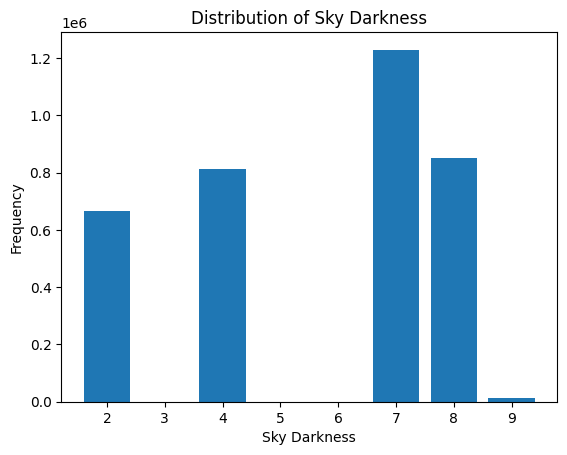

In [0]:
# See distribution of sky_darkness
otpw_1y_weather_subset.cache()
clouds = otpw_1y_weather_subset.select("SkyDarkness")
clouds_data = clouds.toPandas()["SkyDarkness"]

# Create a bar plot
plt.bar(x=clouds_data.value_counts().index, height=clouds_data.value_counts())

# Set the plot title and axis labels
plt.title("Distribution of Sky Darkness")
plt.xlabel("Sky Darkness")
plt.ylabel("Frequency")

# Show the plot
plt.show()

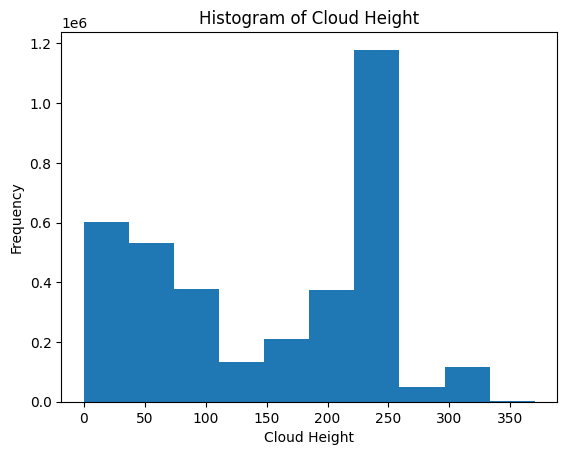

In [0]:
# See distribution of CloudHeight
otpw_1y_weather_subset.cache()
clouds = otpw_1y_weather_subset.select("CloudHeight")
clouds_data = clouds.toPandas()["CloudHeight"]

# Create a histogram plot
plt.hist(clouds_data, bins=10)
plt.xlabel("Cloud Height")
plt.ylabel("Frequency")
plt.title("Histogram of Cloud Height")

# Show the plot
plt.show()

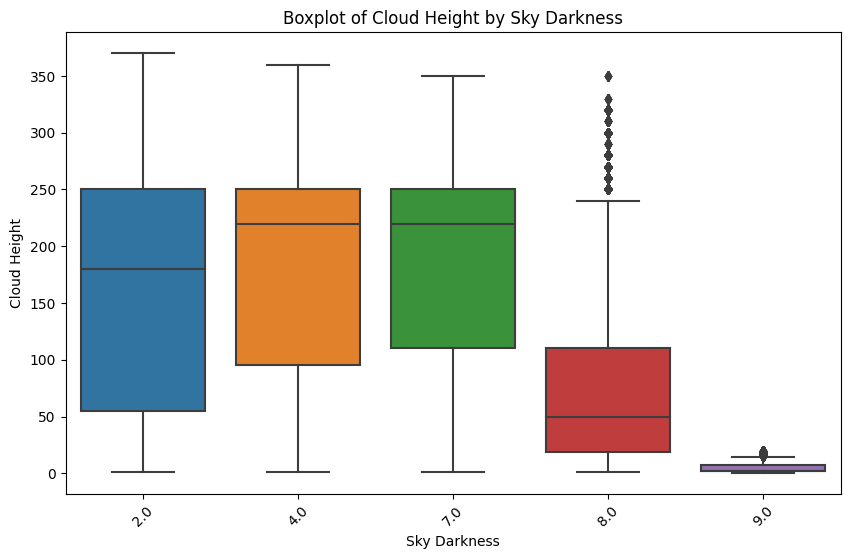

In [0]:
clouds_df = otpw_1y_weather_subset.select("SkyDarkness", "CloudHeight").toPandas()

plt.figure(figsize=(10, 6))
sns.boxplot(x="SkyDarkness", y="CloudHeight", data=clouds_df)
plt.title("Boxplot of Cloud Height by Sky Darkness")
plt.xlabel("Sky Darkness")
plt.ylabel("Cloud Height")
plt.xticks(rotation=45)

plt.show()

View correlation between new cloud variables, to see if feature extraction makes sense, or some cloud layers should be dropped

In [0]:
clouds_df.corr()

,SkyDarkness,CloudHeight
SkyDarkness,1.000000,-0.177276
CloudHeight,-0.177276,1.000000


### b. Create a new composite, concatenated variable, `CloudHeightandDarkness`

In [0]:
otpw_1y_weather_subset = otpw_1y_weather_subset.withColumn("CloudHeightandDarkness", F.concat("SkyDarkness", F.lit("-"), "CloudHeight"))



In [0]:
# Count distinct values for CloudHeightandDarkness, to see how many columns we would add with OHE
otpw_1y_weather_subset.select("CloudHeightandDarkness").distinct().count()


420

In [0]:

# Create a StringIndexer to encode the string values as numeric indices
indexer = StringIndexer(inputCol='CloudHeightandDarkness', outputCol='CloudHeightandDarkness_indexed')

#leave NULLS (otherwise I can't save as parquet)
indexer.setHandleInvalid("keep")  

# Fit and transform the indexer on the DataFrame
otpw_1y_weather_subset = indexer.fit(otpw_1y_weather_subset).transform(otpw_1y_weather_subset)

# Create a OneHotEncoder to convert the indexed column to a one-hot encoded vector column
encoder = OneHotEncoder(inputCol='CloudHeightandDarkness_indexed', outputCol='CloudHeightandDarkness_encoded')

# Fit and transform the encoder on the indexed DataFrame
otpw_1y_weather_subset = encoder.fit(otpw_1y_weather_subset).transform(otpw_1y_weather_subset)

In [0]:
#drop non ohe column 'CloudHeightandDarkness' and intermediate step ('CloudHeightandDarkness') to creating ohe `CloudHeightandDarkness_encoded`
otpw_1y_weather_subset = otpw_1y_weather_subset.drop('CloudHeightandDarkness', 'CloudHeightandDarkness_indexed')


**Conclusion regarding clouds:**
- Low collineality between `CloudHeight` and `SkyDarkness` cloud-related variables, so not a candidate for feature extraction. 
- They are not independent, but they are also not correlated. 
- Will include `CloudHeight`, `SkyDarkness` and  into Lasso, to see what prevails. 
- I don't think it makes a lot of sense to add the concatenated variable `CloudHeightandDarkness`, since there are 420 unique values, which would mean 420 columns with a large percentage of nulls, which we might end up dropping regardless. 
- Nonetheless, I left them as a one-hot-encoding vector. `CloudHeightandDarkness_encoded` and dropped `CloudHeightandDarkness`. 


In [0]:
otpw_1y_weather_subset.columns

['ELEVATION',
 'HourlyAltimeterSetting',
 'HourlyDewPointTemperature',
 'HourlyDryBulbTemperature',
 'HourlyRelativeHumidity',
 'HourlySeaLevelPressure',
 'HourlyStationPressure',
 'HourlyWetBulbTemperature',
 'HourlyWindSpeed',
 'HourlyWindDirection',
 'HourlySkyConditions',
 'cloud_layer_1',
 'cloud_layer_2',
 'cloud_layer_3',
 'cl1_layer_amount',
 'cl1_cloud_height',
 'cl2_layer_amount',
 'cl2_cloud_height',
 'cl3_layer_amount',
 'cl3_cloud_height',
 'SkyDarkness',
 'CloudHeight',
 'CloudHeightandDarkness']

In [0]:
# Drop irrelevant cloud variables from otpw_1y_weather_subset
to_drop = ['HourlySkyConditions','cloud_layer_1',
 'cloud_layer_2',
 'cloud_layer_3',
 'cl1_layer_amount',
 'cl1_cloud_height',
 'cl2_layer_amount',
 'cl2_cloud_height',
 'cl3_layer_amount',
 'cl3_cloud_height']
otpw_1y_weather_with_clouds = otpw_1y_weather_subset.drop(*to_drop)

##2. Feature extraction based on LCD suggestions

- Wind Chill 

### a. WindChill

Used `HourlyDryBulbTemperature` and `HourlyWindSpeed` to calculate it, and the following formula, base on the LCD data dictionary https://www.ncei.noaa.gov/pub/data/cdo/documentation/LCD_documentation.pdf: 

$$WindChill = 35.74 + 0.62115T - (35.75V^0.16) + (0.4275T)*(V^0.16)$$

Where 
- V = `HourlyWindSpeed`
- T = `HourlyDryBulbTemperature`

In [0]:
# Using Wind Chill formula from LCD data dictionary. 
otpw_1y_weather_with_clouds = otpw_1y_weather_with_clouds.withColumn("WindChill", 35.74 + (0.62115*otpw_1y_weather_with_clouds["HourlyDryBulbTemperature"]) - (35.75*(otpw_1y_weather_with_clouds["HourlyWindSpeed"]**0.16)) + ((0.4275*otpw_1y_weather_with_clouds["HourlyDryBulbTemperature"])*(otpw_1y_weather_with_clouds["HourlyWindSpeed"]**0.16)))

# Cast as float
otpw_1y_weather_with_clouds = otpw_1y_weather_with_clouds.withColumn("WindChill", otpw_1y_weather_with_clouds["WindChill"].cast("float"))

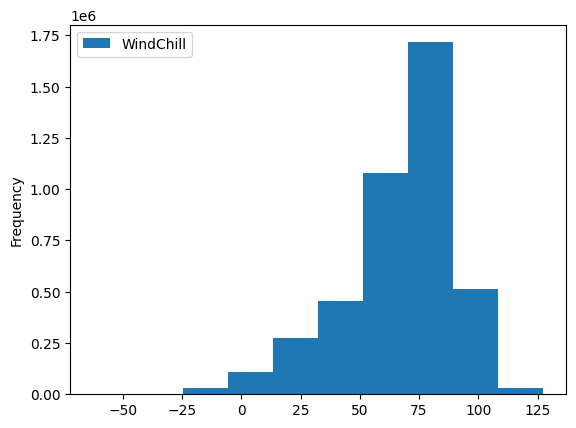

In [0]:
# see distribution of WindChill
otpw_1y_weather_with_clouds.createOrReplaceTempView("weather")
windchill_histogram = spark.sql("SELECT WindChill FROM weather").toPandas().plot(kind="hist", bins=10)

### Checkpoint otpw_1y_weather_with_clouds
-  all weather variables with <50% nulls for flights not cancelled or diverted, excluding `HourlySkyConditions` which has been decomposed into `SkyDarkness` and `CloudHeight`, one-hot-encoded vector `CloudHeightandDarkness_encoded` as well as engineered variable `WindChill`. 

In [0]:
#checkpoint otpw_1y_weather_subset
otpw_1y_weather_with_clouds.write.mode("overwrite").parquet(f"{team_blob_url}/juliana_1y_otpw_weather_raw_num_vars")

In [0]:
# Load checkpointed dataframe
otpw_1y_weather_with_clouds = spark.read.parquet( f"wasbs://{blob_container}@{storage_account}.blob.core.windows.net/juliana_1y_otpw_weather_raw_num_vars" )

## 3. Mean imputation 

- Using PySpark's pyspark.ml.feature Imputer. 
- Default is mean imputation. 

In [0]:
# create lists with variables to impute/not to impute
to_impute = []
not_to_impute = []

for column in otpw_1y_weather_with_clouds.columns:
    if otpw_1y_weather_with_clouds.where(otpw_1y_weather_with_clouds[column].isNull()).count() > 0:
        to_impute.append(column)
    else:
        not_to_impute.append(column)

print(f'Variables that need imputation: {to_impute}')
print(f'Variables that don\'t need imputation: {not_to_impute}')

Variables that need imputation: ['HourlyAltimeterSetting', 'HourlyDewPointTemperature', 'HourlyDryBulbTemperature', 'HourlyRelativeHumidity', 'HourlySeaLevelPressure', 'HourlyStationPressure', 'HourlyWetBulbTemperature', 'HourlyWindSpeed', 'HourlyWindDirection', 'SkyDarkness', 'CloudHeight', 'WindChill']
Variables that don't need imputation: ['ELEVATION', 'CloudHeightandDarkness_encoded']


In [0]:
# perform mean imputation using MLLib on to_impute which will go into PCAs from otpw_1y_weather_with_clouds
to_impute_for_pca = ["HourlyStationPressure","HourlyAltimeterSetting","HourlySeaLevelPressure","HourlyDewPointTemperature",
"HourlyDryBulbTemperature", "HourlyWetBulbTemperature", 'WindChill']

imputer = Imputer(inputCols=to_impute_for_pca, outputCols=to_impute_for_pca)
imputed_data = imputer.fit(otpw_1y_weather_with_clouds).transform(otpw_1y_weather_with_clouds)


In [0]:
# sanity check:  Number of nulls should be zero for all variables which will go into PCA
imputed_data.cache()
for column in imputed_data.columns:
    null_count = imputed_data.where(imputed_data[column].isNull()).count()
    print(f"Number of Nulls in column {column}: {null_count}")
imputed_data.unpersist()


Number of Nulls in column ELEVATION: 0
Number of Nulls in column HourlyAltimeterSetting: 0
Number of Nulls in column HourlyDewPointTemperature: 0
Number of Nulls in column HourlyDryBulbTemperature: 0
Number of Nulls in column HourlyRelativeHumidity: 1461
Number of Nulls in column HourlySeaLevelPressure: 0
Number of Nulls in column HourlyStationPressure: 0
Number of Nulls in column HourlyWetBulbTemperature: 0
Number of Nulls in column HourlyWindSpeed: 2911
Number of Nulls in column HourlyWindDirection: 213459
Number of Nulls in column SkyDarkness: 640414
Number of Nulls in column CloudHeight: 640414
Number of Nulls in column CloudHeightandDarkness_encoded: 0
Number of Nulls in column WindChill: 0


DataFrame[ELEVATION: float, HourlyAltimeterSetting: float, HourlyDewPointTemperature: float, HourlyDryBulbTemperature: float, HourlyRelativeHumidity: float, HourlySeaLevelPressure: float, HourlyStationPressure: float, HourlyWetBulbTemperature: float, HourlyWindSpeed: float, HourlyWindDirection: int, SkyDarkness: float, CloudHeight: float, CloudHeightandDarkness_encoded: vector, WindChill: float]

### Checkpoint imputed data

In [0]:
#checkpoint 
imputed_data.write.mode("overwrite").parquet(f"{team_blob_url}/juliana_1y_otpw_weather_imputed")

In [0]:
# Load checkpointed dataframe
imputed_data = spark.read.parquet( f"wasbs://{blob_container}@{storage_account}.blob.core.windows.net/juliana_1y_otpw_weather_imputed")

## 4. Normalization (NOT DONE - RAY WILL DO IT)
- based on `imputed_data`
- using StandardScaler

The StandardScaler approach groups all features into one, because of the vector assembler. See code below: 

In [0]:
# # Collect the column names to be standardized
# columns_to_standardize = imputed_data.columns

# # Define the VectorAssembler
# assembler = VectorAssembler(inputCols=columns_to_standardize, outputCol="features")

# # Transform the data to create the "features" column
# assembled_data = assembler.transform(imputed_data)

# # Define the StandardScaler transformer, withMean=True, to get z scores.
# scaler = StandardScaler(inputCol="features", outputCol="scaledFeatures", withMean=True, withStd=True)

# # Fit the scaler to the data
# scaler_model = scaler.fit(assembled_data)

# # Apply the scaling transformation to the data
# scaled_data = scaler_model.transform(assembled_data)

Which leads to not being able to see the distributions: 

In [0]:
# Display summary statistics for scaledfeatures
# display(imputed_data.describe())
# display(scaled_data.describe())

summary,ELEVATION,HourlyAltimeterSetting,HourlyDewPointTemperature,HourlyDryBulbTemperature,HourlyPressureChange,HourlyPressureTendency,HourlyRelativeHumidity,HourlySeaLevelPressure,HourlyStationPressure,HourlyWetBulbTemperature,HourlyWindSpeed,HourlyWindDirection,DEP_DELAY,cl1_layer_amount,cl1_cloud_height,cl2_layer_amount,cl2_cloud_height,cl3_layer_amount,cl3_cloud_height
count,4293945,4293945,4293945,4293945,4293945,4293945,4293945,4293945,4293945,4293945,4293945,4293945,4293945,4293945,4293945,4293945,4293945,4293945,4293945
mean,253.46698936562478,30.029143095212646,48.97655458056572,66.12697297121939,0.002851018706786328,4.501027118211495,59.11042258305185,30.013698522110854,29.13965977042757,56.80138031665506,8.90156727929589,177.76552191516194,9.776485260058058,3.7605588139476116,78.88202948446371,5.489617426356224,136.20874324767973,6.664889824332152,171.17487995560376
stddev,401.0341114009203,0.17018077329920464,19.202409856976107,19.452285434234785,0.023810572461809634,1.6632597372320819,21.415204648327585,0.17815918633103006,1.3167659022249294,16.302067300717617,5.2134873419831145,104.41303896108721,37.11777452807499,2.024941292960084,71.07087009443748,1.3968036923506628,63.31588855376038,0.7109616446498981,40.30978677496804
min,0.3,28.62,-38.0,-40.0,-0.36,0.0,1.0,28.63,19.81,-32.0,0.0,0,-68.0,2.0,0.0,2.0,2.0,2.0,6.0
max,2353.1,31.09,86.0,116.0,0.31,9.0,100.0,31.18,30.96,87.0,57.0,360,1988.0,9.0,370.0,8.0,360.0,8.0,360.0


summary,ELEVATION,HourlyAltimeterSetting,HourlyDewPointTemperature,HourlyDryBulbTemperature,HourlyPressureChange,HourlyPressureTendency,HourlyRelativeHumidity,HourlySeaLevelPressure,HourlyStationPressure,HourlyWetBulbTemperature,HourlyWindSpeed,HourlyWindDirection,DEP_DELAY,cl1_layer_amount,cl1_cloud_height,cl2_layer_amount,cl2_cloud_height,cl3_layer_amount,cl3_cloud_height
count,4293945,4293945,4293945,4293945,4293945,4293945,4293945,4293945,4293945,4293945,4293945,4293945,4293945,4293945,4293945,4293945,4293945,4293945,4293945
mean,253.46698936562478,30.029143095212646,48.97655458056572,66.12697297121939,0.002851018706786328,4.501027118211495,59.11042258305185,30.013698522110854,29.13965977042757,56.80138031665506,8.90156727929589,177.76552191516194,9.776485260058058,3.7605588139476116,78.88202948446371,5.489617426356224,136.20874324767973,6.664889824332152,171.17487995560376
stddev,401.0341114009203,0.17018077329920464,19.202409856976107,19.452285434234785,0.023810572461809634,1.6632597372320819,21.415204648327585,0.17815918633103006,1.3167659022249294,16.302067300717617,5.2134873419831145,104.41303896108721,37.11777452807499,2.024941292960084,71.07087009443748,1.3968036923506628,63.31588855376038,0.7109616446498981,40.30978677496804
min,0.3,28.62,-38.0,-40.0,-0.36,0.0,1.0,28.63,19.81,-32.0,0.0,0,-68.0,2.0,0.0,2.0,2.0,2.0,6.0
max,2353.1,31.09,86.0,116.0,0.31,9.0,100.0,31.18,30.96,87.0,57.0,360,1988.0,9.0,370.0,8.0,360.0,8.0,360.0


Trying another method to scale: USED THIS ONE, but Ray will probably use the other one in the pipeline. 

In [0]:
# # Select columns to standardize
# columns_to_standardize = imputed_data.columns

# # Store new variables in a new df
# scaled2_data = imputed_data.select('*')
# scaled2_data.cache()

# # Standardize each column individually
# for col_name in columns_to_standardize:
#     col_mean = scaled2_data.select(F.mean(col_name)).collect()[0][0]
#     col_std = scaled2_data.select(F.stddev(col_name)).collect()[0][0]
#     scaled_col = (F.col(col_name) - col_mean) / col_std
#     scaled2_data = scaled2_data.withColumn(f"scaled_{col_name}", scaled_col)

# # Drop all columns that don't start with "scaled_"
# columns_to_keep = [col for col in scaled2_data.columns if col.startswith("scaled_")]
# scaled2_data = scaled2_data.select(columns_to_keep)

# # Compare distributions
# display(imputed_data.describe())
# display(scaled2_data.describe())

# scaled2_data.unpersist()


summary,ELEVATION,HourlyAltimeterSetting,HourlyDewPointTemperature,HourlyDryBulbTemperature,HourlyRelativeHumidity,HourlySeaLevelPressure,HourlyStationPressure,HourlyWetBulbTemperature,HourlyWindSpeed,HourlyWindDirection,DEP_DELAY,SkyDarkness,CloudHeight,WindChill
count,4213746,4213746,4213746,4213746,4213746,4213746,4213746,4213746,4213746,4213746,4213746,4213746,4213746,4213746
mean,251.3535489280479,30.02911971509712,49.12253524764478,66.19776972319532,59.242995666438205,30.01304686508213,29.144411371081183,56.89241649242573,8.915621248210016,177.80444739668692,9.820609500430258,5.629953482416066,152.6979505659252,67.2195342575654
stddev,398.18607424256294,0.1715711205634481,19.16994890732896,19.425542162278518,21.393359419229807,0.17763080084065067,1.3126449061346046,16.30290716152177,5.218491889630011,104.4423307479635,37.142358730754275,2.0764000542926575,88.57747148556037,23.474812283879416
min,0.3,28.62,-38.0,-40.0,1.0,28.63,19.81,-32.0,0.0,0,-68.0,2.0,0.0,-62.818203
max,2353.1,31.09,86.0,116.0,100.0,31.18,30.96,87.0,52.0,360,1988.0,9.0,370.0,127.5215


summary,scaled_ELEVATION,scaled_HourlyAltimeterSetting,scaled_HourlyDewPointTemperature,scaled_HourlyDryBulbTemperature,scaled_HourlyRelativeHumidity,scaled_HourlySeaLevelPressure,scaled_HourlyStationPressure,scaled_HourlyWetBulbTemperature,scaled_HourlyWindSpeed,scaled_HourlyWindDirection,scaled_DEP_DELAY,scaled_SkyDarkness,scaled_CloudHeight,scaled_WindChill
count,4213746,4213746,4213746,4213746,4213746,4213746,4213746,4213746,4213746,4213746,4213746,4213746,4213746,4213746
mean,-3.781735035908237E-16,-6.992593654239073E-15,1.8475899228800847E-16,-1.3687490065355207E-15,1.8025333345154566E-16,-5.337344101689189E-15,1.0912395431993083E-15,-1.7773070410298713E-16,3.303160546994871E-16,-6.586086099215209E-16,4.422627907904654E-16,3.6891093473278095E-16,3.1858852622799325E-15,4.741194175638395E-16
stddev,1.0000000000000016,1.0000000000000047,0.9999999999999912,1.0000000000000102,1.0000000000000004,1.0000000000000016,0.9999999999999933,1.000000000000004,0.9999999999999978,1.0000000000000009,0.9999999999999986,0.9999999999999961,1.0000000000000016,1.0000000000000053
min,-0.6304930412086504,-8.213030673437965,-4.544745302598929,-5.466914067882,-2.7224801175492535,-7.786080441962521,-7.111147776153873,-5.452550002997637,-1.7084670124575263,-1.7024174596960906,-2.0951983708022817,-1.7481956210276823,-1.7238915042953962,-5.539458022387544
max,5.278302493943777,6.183327555399684,1.9237122086567695,2.563749822824154,1.9051240870999728,6.56954444032768,1.38315221801904,1.8467616363929489,8.256097674005325,1.744460807208342,53.25939057450371,1.623023709047228,2.4532428594950213,2.5687943591197167


DataFrame[scaled_ELEVATION: double, scaled_HourlyAltimeterSetting: double, scaled_HourlyDewPointTemperature: double, scaled_HourlyDryBulbTemperature: double, scaled_HourlyRelativeHumidity: double, scaled_HourlySeaLevelPressure: double, scaled_HourlyStationPressure: double, scaled_HourlyWetBulbTemperature: double, scaled_HourlyWindSpeed: double, scaled_HourlyWindDirection: double, scaled_DEP_DELAY: double, scaled_SkyDarkness: double, scaled_CloudHeight: double, scaled_WindChill: double]

## 5. Feature extraction with PCA

- Goal: To generate one component per each pair/trio of variables with high collinearity. So k will be set to 1. 
- **NOTE** PCA can't be done with nulls, so the steps below are done one imputed/scaled data, from the imputed_data checkpoint. 





### Pearson correlation matrix 

- Confirmation to see which variables show high collinearity

/root/.ipykernel/1342/command-1835145152852952-1087617771:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = imputed_data.toPandas().corr()


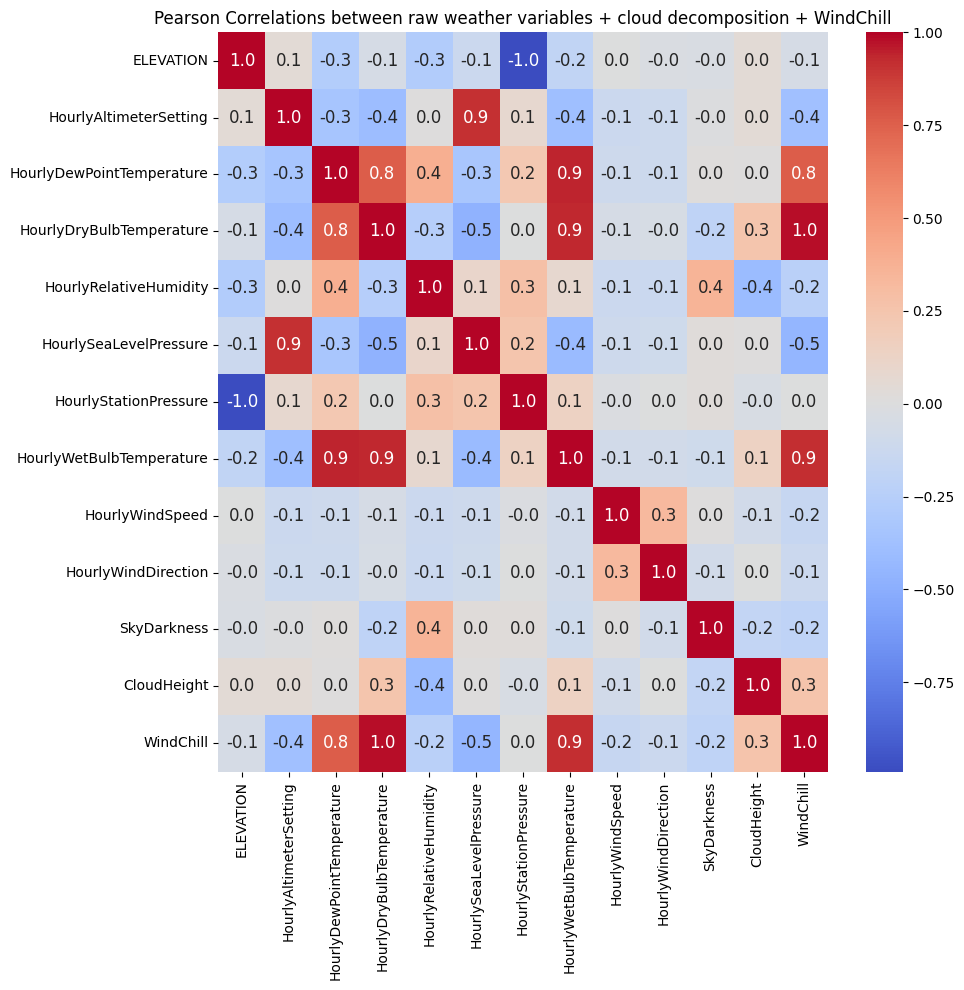

In [0]:
# Calculate the Pearson correlation matrix
correlation_matrix = imputed_data.toPandas().corr()
plt.figure(figsize=(10, 10))
plt.title('Pearson Correlations between raw weather variables + cloud decomposition + WindChill')
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", annot_kws={"fontsize": 12}, fmt=".1f")
plt.tight_layout()
plt.show()

- Since same variables are still correlated, then we will carry out PCA by pairs/trios of correlated variables. 

And let's look at the distribution, to see if we have any skewed variables.

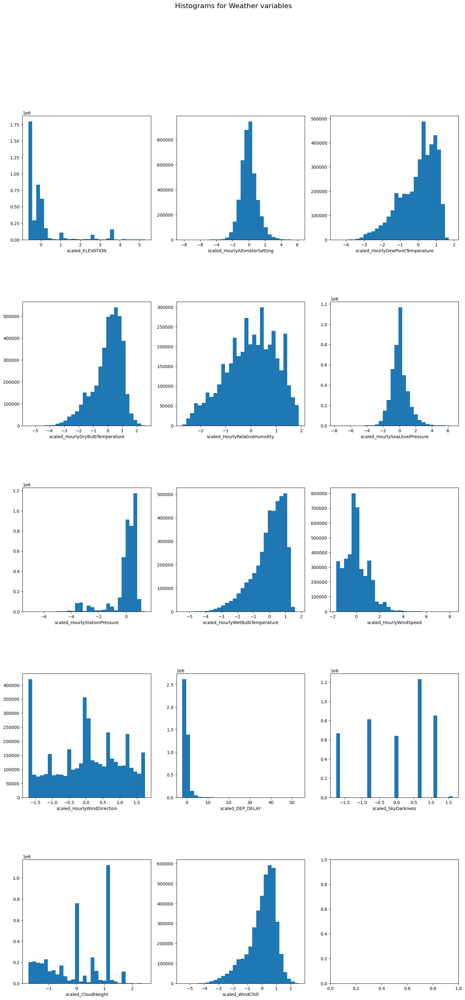

DataFrame[scaled_ELEVATION: double, scaled_HourlyAltimeterSetting: double, scaled_HourlyDewPointTemperature: double, scaled_HourlyDryBulbTemperature: double, scaled_HourlyRelativeHumidity: double, scaled_HourlySeaLevelPressure: double, scaled_HourlyStationPressure: double, scaled_HourlyWetBulbTemperature: double, scaled_HourlyWindSpeed: double, scaled_HourlyWindDirection: double, scaled_DEP_DELAY: double, scaled_SkyDarkness: double, scaled_CloudHeight: double, scaled_WindChill: double]

In [0]:
# Cache the DataFrame
scaled2_data.cache()

# Create a figure and axis subplots
num_cols = len(scaled2_data.columns)
ncols = 3  # Number of columns for the subplots
nrows = (num_cols + ncols - 1) // ncols  # Calculate the number of rows based on the number of columns
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(18, 36))

# Flatten the axes
axes = axes.flatten()

# Loop through each non-string column and create a histogram
for idx, col in enumerate(scaled2_data.columns):
    # Convert the column to a Pandas Series
    col_values = scaled2_data.select(col).toPandas()[col]
    
    # Plot the histogram
    axes[idx].hist(col_values.dropna(), bins=30)
    axes[idx].set_xlabel(col)
    # axes[idx].set_title(f"{col}")

# Adjust spacing between subplots
plt.subplots_adjust(hspace=0.5)
fig.suptitle("Histograms for Weather variables", fontsize=16)
plt.show()

# Unpersist 
scaled2_data.unpersist()

### ELEVATION and HourlyStationPressure

In [0]:
vars_list = ['ELEVATION','HourlyStationPressure']
imputed_data.cache()
elevation_pressure = imputed_data.select(*vars_list)

assembler = VectorAssembler(inputCols=vars_list, outputCol="features")
elevation_pressure = assembler.transform(elevation_pressure)

pca = PCA(k=1, inputCol="features", outputCol="pca_elevation_station_pressure") #changed it to now to make it easier
pca_model = pca.fit(elevation_pressure)
elevation_pressure_pca = pca_model.transform(elevation_pressure)

imputed_data.unpersist()
display(elevation_pressure_pca)


ELEVATION,HourlyStationPressure,features,pca_elevation_station_pressure
134.1,29.8,"Map(vectorType -> dense, length -> 2, values -> List(134.10000610351562, 29.799999237060547))","Map(vectorType -> dense, length -> 1, values -> List(-134.00202010471554))"
337.4,28.66,"Map(vectorType -> dense, length -> 2, values -> List(337.3999938964844, 28.65999984741211))","Map(vectorType -> dense, length -> 1, values -> List(-337.30464597508626))"
15.5,29.97,"Map(vectorType -> dense, length -> 2, values -> List(15.5, 29.969999313354492))","Map(vectorType -> dense, length -> 1, values -> List(-15.402090918928659))"
15.5,29.94,"Map(vectorType -> dense, length -> 2, values -> List(15.5, 29.940000534057617))","Map(vectorType -> dense, length -> 1, values -> List(-15.40218883937801))"
717.2,27.3,"Map(vectorType -> dense, length -> 2, values -> List(717.2000122070312, 27.299999237060547))","Map(vectorType -> dense, length -> 1, values -> List(-717.1070802030487))"
717.2,27.42,"Map(vectorType -> dense, length -> 2, values -> List(717.2000122070312, 27.420000076293945))","Map(vectorType -> dense, length -> 1, values -> List(-717.1066885025737))"
289.3,29.13,"Map(vectorType -> dense, length -> 2, values -> List(289.29998779296875, 29.1299991607666))","Map(vectorType -> dense, length -> 1, values -> List(-289.20336196965565))"
13.4,30.38,"Map(vectorType -> dense, length -> 2, values -> List(13.399999618530273, 30.3799991607666))","Map(vectorType -> dense, length -> 1, values -> List(-13.300763424786012))"
5.8,30.01,"Map(vectorType -> dense, length -> 2, values -> List(5.800000190734863, 30.010000228881836))","Map(vectorType -> dense, length -> 1, values -> List(-5.702012216004932))"
148.7,29.61,"Map(vectorType -> dense, length -> 2, values -> List(148.6999969482422, 29.610000610351562))","Map(vectorType -> dense, length -> 1, values -> List(-148.60255335385833))"


In [0]:
# Get the explained variance ratio for each principal component
explained_variance_ratio = pca_model.explainedVariance.toArray()

# Print the explained variance ratio for each component
for i, var in enumerate(explained_variance_ratio):
    print(f"Principal Component {i+1} explains {var*100:.2f}% of the variance")

Principal Component 1 explains 99.51% of the variance


In [0]:
# Add a unique ID column to each DataFrame
imputed_data = imputed_data.withColumn("id", F.monotonically_increasing_id())
print(f'There were originally {imputed_data.count()} rows and {len(imputed_data.columns)} weather columns in the imputed_data dataframe.')
elevation_pressure_pca = elevation_pressure_pca.withColumn("id", F.monotonically_increasing_id())

# Join the DataFrames based on the ID column
imputed_data = imputed_data.join(elevation_pressure_pca.select("id", "pca_elevation_station_pressure"), "id", "left")

# check that number of rows is the same, and column is +1
print(f'There are now {imputed_data.count()} rows and {len(imputed_data.columns)} weather columns in the imputed_data dataframe.')

There were originally 4213746 rows and 15 weather columns in the imputed_data dataframe.
There are now 4213746 rows and 16 weather columns in the imputed_data dataframe.


### HourlyAltimeterSetting and HourlySeaLevelPressure

In [0]:
vars_list = ['HourlyAltimeterSetting','HourlySeaLevelPressure']
altimeter_sealevel = imputed_data.select(*vars_list)

assembler = VectorAssembler(inputCols=vars_list, outputCol="features")
altimeter_sealevel = assembler.transform(altimeter_sealevel)

pca = PCA(k=1, inputCol="features", outputCol="pca_altimeter_sea_level_pressure")
pca_model = pca.fit(altimeter_sealevel)
altimeter_sealevel_pca = pca_model.transform(altimeter_sealevel)

# Get the explained variance ratio for each principal component
explained_variance_ratio = pca_model.explainedVariance.toArray()

# Print the explained variance ratio for each component
for i, var in enumerate(explained_variance_ratio):
    print(f"Principal Component {i+1} explains {var*100:.2f}% of the variance")

Principal Component 1 explains 95.36% of the variance


In [0]:
# Add a unique ID column to each DataFrame
imputed_data = imputed_data.withColumn("id", F.monotonically_increasing_id())
print(f'There were originally {imputed_data.count()} rows and {len(imputed_data.columns)} weather columns in the imputed_data dataframe.')
altimeter_sealevel_pca = altimeter_sealevel_pca.withColumn("id", F.monotonically_increasing_id())

# Join the DataFrames based on the ID column
imputed_data = imputed_data.join(altimeter_sealevel_pca.select("id", "pca_altimeter_sea_level_pressure"), "id", "left")

# check that number of rows is the same, and column is +1
print(f'There are now {imputed_data.count()} rows and {len(imputed_data.columns)} weather columns in the imputed_data dataframe.')

There were originally 4213746 rows and 16 weather columns in the imputed_data dataframe.
There are now 4213746 rows and 17 weather columns in the imputed_data dataframe.


### HourlyDewPointTemperature, HourlyWetBulbTemperature, WindChill


In [0]:
vars_list = ['HourlyDewPointTemperature','WindChill','HourlyWetBulbTemperature']
wet_bulbs = imputed_data.select(*vars_list)

assembler = VectorAssembler(inputCols=vars_list, outputCol="features")
wet_bulbs = assembler.transform(wet_bulbs)

pca = PCA(k=1, inputCol="features", outputCol="pca_dew_windchill_wet_temp")
pca_model = pca.fit(wet_bulbs)
wet_bulbs_pca = pca_model.transform(wet_bulbs)

# Get the explained variance ratio for each principal component
explained_variance_ratio = pca_model.explainedVariance.toArray()

# Print the explained variance ratio for each component
for i, var in enumerate(explained_variance_ratio):
    print(f"Principal Component {i+1} explains {var*100:.2f}% of the variance")

Principal Component 1 explains 90.57% of the variance


In [0]:
# Add a unique ID column to each DataFrame
imputed_data = imputed_data.withColumn("id", F.monotonically_increasing_id())
print(f'There were originally {imputed_data.count()} rows and {len(imputed_data.columns)} weather columns in the imputed_data dataframe.')
wet_bulbs_pca = wet_bulbs_pca.withColumn("id", F.monotonically_increasing_id())

# Join the DataFrames based on the ID column
imputed_data = imputed_data.join(wet_bulbs_pca.select("id", "pca_dew_windchill_wet_temp"), "id", "left")

# check that number of rows is the same, and column is +1
print(f'There are now {imputed_data.count()} rows and {len(imputed_data.columns)} weather columns in the imputed_data dataframe.')

There were originally 4213746 rows and 17 weather columns in the imputed_data dataframe.
There are now 4213746 rows and 18 weather columns in the imputed_data dataframe.



**ORIGINAL VARIABLES --> Extraction**:
- `ELEVATION` --> `pca_elevation_station_pressure`
- `HourlyAltimeterSetting` --> `pca_altimeter_sea_level_pressure`
- `HourlyDewPointTemperature` --> `pca_dew_windchill_wet_temp`
- `HourlyDryBulbTemperature` --> `WindChill` --> `pca_dew_windchill_wet_temp`
- `HourlyRelativeHumidity` --> `HourlyRelativeHumidity`
- `HourlySeaLevelPressure` --> `pca_altimeter_sea_level_pressure`
- `HourlyStationPressure` --> `pca_elevation_station_pressure`
- `HourlyWetBulbTemperature` --> `pca_dew_windchill_wet_temp`
- `HourlyWindSpeed` --> `WindChill` --> `pca_dew_windchill_wet_temp`
- `HourlySkyConditions` --> `SkyDarkness` and `CloudHeight`
- `HourlyWindDirection` --> `HourlyWindDirection`

**"FINAL" VARIABLES:**
- `SkyDarkness`
- `CloudHeight`
- `CloudHeightandDarkness_encoded`
- `HourlyRelativeHumidity`
- `HourlyWindDirection`
- `pca_elevation_station_pressure`
- `pca_altimeter_sea_level_pressure`
- `pca_dew_windchill_wet_temp`

In [0]:
final_cols = ["SkyDarkness", "CloudHeight","CloudHeightandDarkness_encoded","HourlyRelativeHumidity","HourlyWindDirection","pca_elevation_station_pressure","pca_altimeter_sea_level_pressure","pca_dew_windchill_wet_temp"]

final_vars = imputed_data.select(*final_cols)

#### Chechpoint "final variables"



In [0]:
#checkpoint 
final_vars.write.mode("overwrite").parquet(f"{team_blob_url}/juliana_1y_otpw_weather_final_vars")

In [0]:
final_vars = spark.read.parquet( f"wasbs://{blob_container}@{storage_account}.blob.core.windows.net/juliana_1y_otpw_weather_final_vars")

#### Checkpoint Feature engineered data

Add feature engineered variables from final_vars checkpoint to raw dataset. 
- `SkyDarkness`
- `CloudHeight`
- `CloudHeightandDarkness_encoded`
- `pca_elevation_station_pressure`
- `pca_altimeter_sea_level_pressure`
- `pca_dew_windchill_wet_temp`


In [0]:
# Add id column to otpw_1y_train_subset for concatenating columns
otpw_1y_train_subset = otpw_1y_train_subset.withColumn("id", F.monotonically_increasing_id())

# Add id column to final_vars for concatenating columns
final_vars = final_vars.withColumn("id", F.monotonically_increasing_id())

# Join the DataFrames based on the ID column
otpw_1y_train_subset = otpw_1y_train_subset.join(final_vars.select("id","SkyDarkness","CloudHeight","CloudHeightandDarkness_encoded","pca_elevation_station_pressure","pca_altimeter_sea_level_pressure","pca_dew_windchill_wet_temp"), "id", "left")

display(otpw_1y_train_subset)

id,DEP_DELAY,sched_depart_date_time,sched_depart_date_time_UTC,two_hours_prior_depart_UTC,four_hours_prior_depart_UTC,OP_UNIQUE_CARRIER,TAIL_NUM,OP_CARRIER_FL_NUM,ORIGIN,DEST,origin_type,origin_region,origin_station_id,HourlySkyConditions,YEAR,QUARTER,MONTH,DAY_OF_MONTH,DAY_OF_WEEK,HourlyWindDirection,CRS_ELAPSED_TIME,DISTANCE,ELEVATION,HourlyStationPressure,HourlyAltimeterSetting,HourlySeaLevelPressure,HourlyDewPointTemperature,HourlyDryBulbTemperature,HourlyWetBulbTemperature,HourlyRelativeHumidity,HourlyWindSpeed,SkyDarkness,CloudHeight,CloudHeightandDarkness_encoded,pca_elevation_station_pressure,pca_altimeter_sea_level_pressure,pca_dew_windchill_wet_temp
0,7.0,2015-03-01T11:15:00Z,2015-03-01T17:15:00Z,2015-03-01T15:15:00Z,2015-03-01T13:15:00Z,WN,N7727A,1068,DAL,LIT,large_airport,US-TX,72258013960,OVC:08 8,2015,1,3,1,7,350,60,296.0,134.1,29.8,30.33,null,36.0,38.0,37.0,93.0,11.0,8.0,8.0,"Map(vectorType -> sparse, length -> 419, indices -> List(63), values -> List(1.0))","Map(vectorType -> dense, length -> 1, values -> List(-134.00202010471554))","Map(vectorType -> dense, length -> 1, values -> List(-42.656884273880294))","Map(vectorType -> dense, length -> 1, values -> List(-58.60614278466234))"
7,25.0,2015-03-05T09:25:00Z,2015-03-05T15:25:00Z,2015-03-05T13:25:00Z,2015-03-05T11:25:00Z,WN,N242WN,1070,HOU,SNA,large_airport,US-TX,72244012918,OVC:08 17,2015,1,3,5,4,360,220,1357.0,13.4,30.38,30.43,30.45,34.0,40.0,38.0,79.0,21.0,7.0,250.0,"Map(vectorType -> sparse, length -> 419, indices -> List(0), values -> List(1.0))","Map(vectorType -> dense, length -> 1, values -> List(-28.90280239450056))","Map(vectorType -> dense, length -> 1, values -> List(-42.18520744070503))","Map(vectorType -> dense, length -> 1, values -> List(-131.75205017616742))"
19,13.0,2015-08-07T20:40:00Z,2015-08-08T00:40:00Z,2015-08-07T22:40:00Z,2015-08-07T20:40:00Z,WN,N395SW,1081,MCO,PIT,large_airport,US-FL,72205012815,FEW:02 150 BKN:07 250,2015,3,8,7,5,220,135,834.0,27.4,29.81,29.92,29.91,77.0,81.0,78.0,88.0,11.0,7.0,9.0,"Map(vectorType -> sparse, length -> 419, indices -> List(278), values -> List(1.0))","Map(vectorType -> dense, length -> 1, values -> List(-29.502930142235915))","Map(vectorType -> dense, length -> 1, values -> List(-42.46799948739517))","Map(vectorType -> dense, length -> 1, values -> List(-95.43687331478498))"
22,1.0,2015-08-07T06:20:00Z,2015-08-07T10:20:00Z,2015-08-07T08:20:00Z,2015-08-07T06:20:00Z,WN,N8606C,1084,IND,DEN,large_airport,US-IN,72438093819,BKN:07 250,2015,3,8,7,5,30,170,977.0,241.1,29.05,29.91,29.9,55.0,61.0,58.0,81.0,8.0,7.0,250.0,"Map(vectorType -> sparse, length -> 419, indices -> List(0), values -> List(1.0))","Map(vectorType -> dense, length -> 1, values -> List(-27.301406952235464))","Map(vectorType -> dense, length -> 1, values -> List(-42.814553515216275))","Map(vectorType -> dense, length -> 1, values -> List(-93.54586104032573))"
26,-6.0,2015-04-19T13:25:00Z,2015-04-19T18:25:00Z,2015-04-19T16:25:00Z,2015-04-19T14:25:00Z,WN,N370SW,1087,MKE,MCO,large_airport,US-WI,72640014839,SCT:04 150 OVC:08 200,2015,2,4,19,7,40,165,1066.0,203.3,28.87,29.61,29.62,33.0,50.0,42.0,52.0,9.0,null,null,"Map(vectorType -> sparse, length -> 419, indices -> List(), values -> List())","Map(vectorType -> dense, length -> 1, values -> List(-337.30490710666095))","Map(vectorType -> dense, length -> 1, values -> List(-42.01472152401939))","Map(vectorType -> dense, length -> 1, values -> List(-125.8205299164875))"
29,19.0,2015-09-17T08:35:00Z,2015-09-17T14:35:00Z,2015-09-17T12:35:00Z,2015-09-17T10:35:00Z,WN,N444WN,1091,DEN,BUR,large_airport,US-CO,72565003017,FEW:02 70 FEW:02 140,2015,3,9,17,4,90,145,850.0,1650.2,24.63,30.08,29.86,39.0,71.0,53.0,31.0,14.0,null,null,"Map(vectorType -> sparse, length -> 419, indices -> List(), values -> List())","Map(vectorType -> dense, length -> 1, values -> List(-29.502473163536635))","Map(vectorType -> dense, length -> 1, values -> List(-42.67315749187121))","Map(vectorType -> dense, length -> 1, values -> List(

In [0]:
# Drop irrelevant cloud variables from otpw_1y_train_subset
to_drop = ["id"]
otpw_1y_train_subset_weather_engineered = otpw_1y_train_subset.drop(*to_drop)

In [0]:
#checkpoint 
otpw_1y_train_subset_weather_engineered.write.mode("overwrite").parquet(f"{team_blob_url}/juliana_1y_otpw_weather_engineered")

In [0]:
#load checkpointed otpw_1y_train_subset_weather_engineered
otpw_1y_train_subset_weather_engineered = spark.read.parquet( f"wasbs://{blob_container}@{storage_account}.blob.core.windows.net/juliana_1y_otpw_weather_engineered")

# Final weather variables to place into Lasso 

- `SkyDarkness`
- `CloudHeight`
- `CloudHeightandDarkness_encoded`
- `HourlyRelativeHumidity`
- `HourlyWindDirection`
- `pca_elevation_station_pressure`
- `pca_altimeter_sea_level_pressure`
- `pca_dew_windchill_wet_temp`
